In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import seaborn as sns
from sklearn import metrics 
from sklearn.metrics import confusion_matrix

In [2]:
data=pd.read_csv('blood_samples_dataset_test.csv')
data.head()

,Glucose,Cholesterol,Hemoglobin,Platelets,White Blood Cells,Red Blood Cells,Hematocrit,Mean Corpuscular Volume,Mean Corpuscular Hemoglobin,Mean Corpuscular Hemoglobin Concentration,...,HbA1c,LDL Cholesterol,HDL Cholesterol,ALT,AST,Heart Rate,Creatinine,Troponin,C-reactive Protein,Disease
0,0.001827,0.033693,0.114755,0.997927,0.562604,0.866499,0.578042,0.914615,0.026864,0.038641,...,0.653230,0.186104,0.430398,0.016678,0.885352,0.652733,0.788235,0.054788,0.031313,Thalasse
1,0.436679,0.972653,0.084998,0.180909,0.675736,0.563889,0.798382,0.670361,0.376092,0.184890,...,0.833540,0.153001,0.458533,0.401845,0.635969,0.574425,0.047025,0.607985,0.594123,Diabetes
2,0.545697,0.324815,0.584467,0.475748,0.558596,0.661007,0.934056,0.381782,0.500342,0.531829,...,0.678901,0.220479,0.817151,0.690981,0.101633,0.855740,0.551124,0.413294,0.070909,Heart Di
3,0.172994,0.050351,0.736000,0.782022,0.069435,0.085219,0.032907,0.460619,0.785448,0.491495,...,0.381500,0.459396,0.420154,0.798537,0.399236,0.324600,0.499504,0.436662,0.242766,Diabetes
4,0.758534,0.739968,0.597868,0.772683,0.875720,0.860265,0.486189,0.486686,0.621048,0.191756,...,0.993381,0.272338,0.663579,0.265227,0.918847,0.804910,0.571119,0.188368,0.750848,Heart Di


# Data Preprocessing

In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 486 entries, 0 to 485
Data columns (total 25 columns):
 #   Column                                     Non-Null Count  Dtype  
---  ------                                     --------------  -----  
 0   Glucose                                    486 non-null    float64
 1   Cholesterol                                486 non-null    float64
 2   Hemoglobin                                 486 non-null    float64
 3   Platelets                                  486 non-null    float64
 4   White Blood Cells                          486 non-null    float64
 5   Red Blood Cells                            486 non-null    float64
 6   Hematocrit                                 486 non-null    float64
 7   Mean Corpuscular Volume                    486 non-null    float64
 8   Mean Corpuscular Hemoglobin                486 non-null    float64
 9   Mean Corpuscular Hemoglobin Concentration  486 non-null    float64
 10  Insulin                   

In [4]:
data.shape

(486, 25)

In [5]:
data.isnull().sum()

Glucose                                      0
Cholesterol                                  0
Hemoglobin                                   0
Platelets                                    0
White Blood Cells                            0
Red Blood Cells                              0
Hematocrit                                   0
Mean Corpuscular Volume                      0
Mean Corpuscular Hemoglobin                  0
Mean Corpuscular Hemoglobin Concentration    0
Insulin                                      0
BMI                                          0
Systolic Blood Pressure                      0
Diastolic Blood Pressure                     0
Triglycerides                                0
HbA1c                                        0
LDL Cholesterol                              0
HDL Cholesterol                              0
ALT                                          0
AST                                          0
Heart Rate                                   0
Creatinine   

In [6]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
Glucose,486.0,0.490044,0.284196,0.001827,0.236664,0.496471,0.727144,0.991742
Cholesterol,486.0,0.506797,0.282871,0.003088,0.268021,0.502397,0.754638,0.999606
Hemoglobin,486.0,0.485502,0.298818,0.000719,0.201994,0.477706,0.750028,0.997876
Platelets,486.0,0.528136,0.292610,0.000006,0.276155,0.538642,0.789486,0.999507
White Blood Cells,486.0,0.509783,0.290887,-0.000206,0.264944,0.511102,0.767896,0.999646
Red Blood Cells,486.0,0.504347,0.302865,0.000552,0.218573,0.518103,0.768466,0.997267
Hematocrit,486.0,0.501042,0.294501,0.004556,0.246255,0.496275,0.761107,1.000857
Mean Corpuscular Volume,486.0,0.516185,0.279954,0.000309,0.287755,0.533319,0.746765,0.996362
Mean Corpuscular Hemoglobin,486.0,0.510145,0.285213,-0.000614,0.259967,0.498332,0.761956,0.999234
Mean Corpuscular Hemoglobin Concentration,486.0,0.501105,0.290614,0.000719,0.255839,0.493929,0.734817,0.999666


In [7]:
data.Disease.value_counts()

Diabetes    294
Anemia       84
Thalasse     48
Heart Di     39
Thromboc     16
Healthy       5
Name: Disease, dtype: int64

# Data Visualization

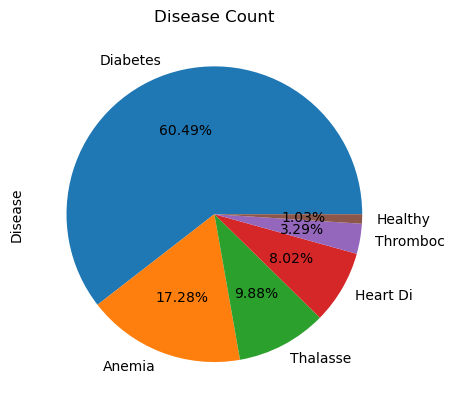

In [8]:
data['Disease'].value_counts().plot(kind='pie',autopct='%1.2f%%')
plt.title("Disease Count")
plt.show()

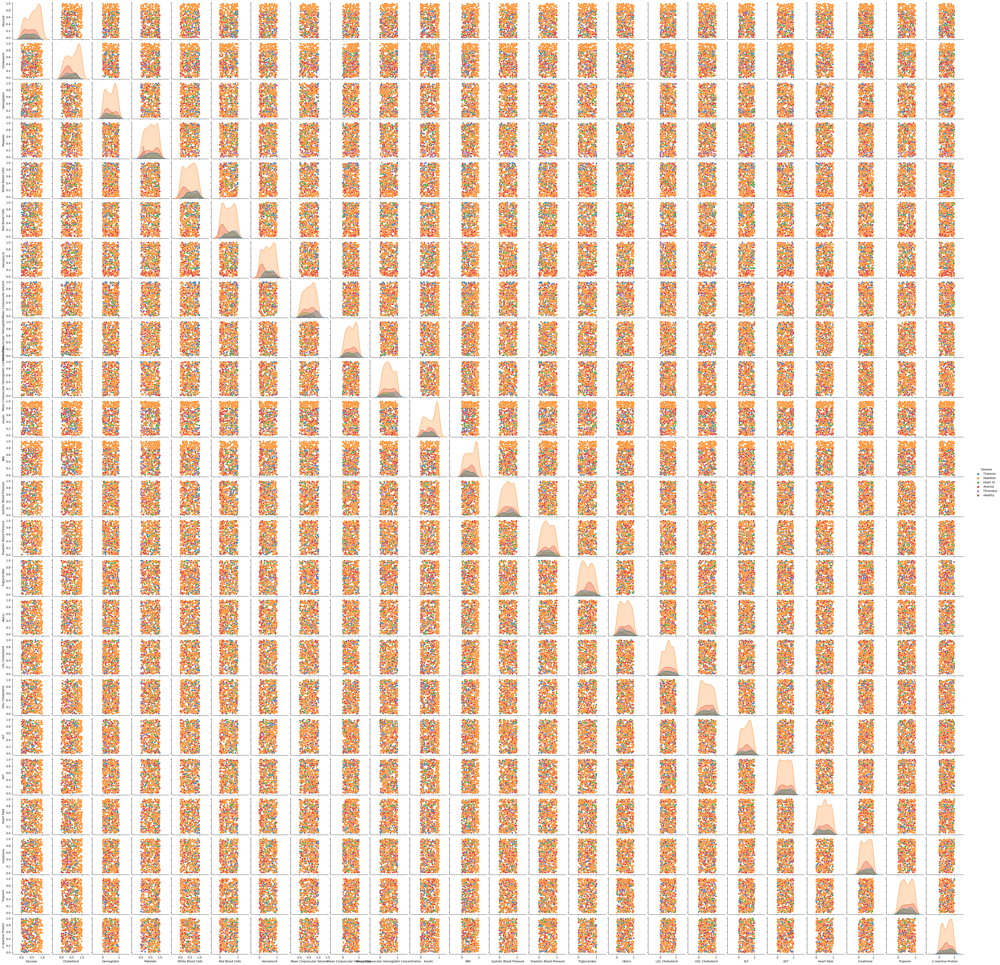

In [9]:
sns.pairplot(hue='Disease',height = 2, data = data)
plt.show()

C:\Users\Srija-Pooja\AppData\Local\Temp\ipykernel_24148\4106473395.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(data.corr(), annot=True,cmap="YlGnBu")


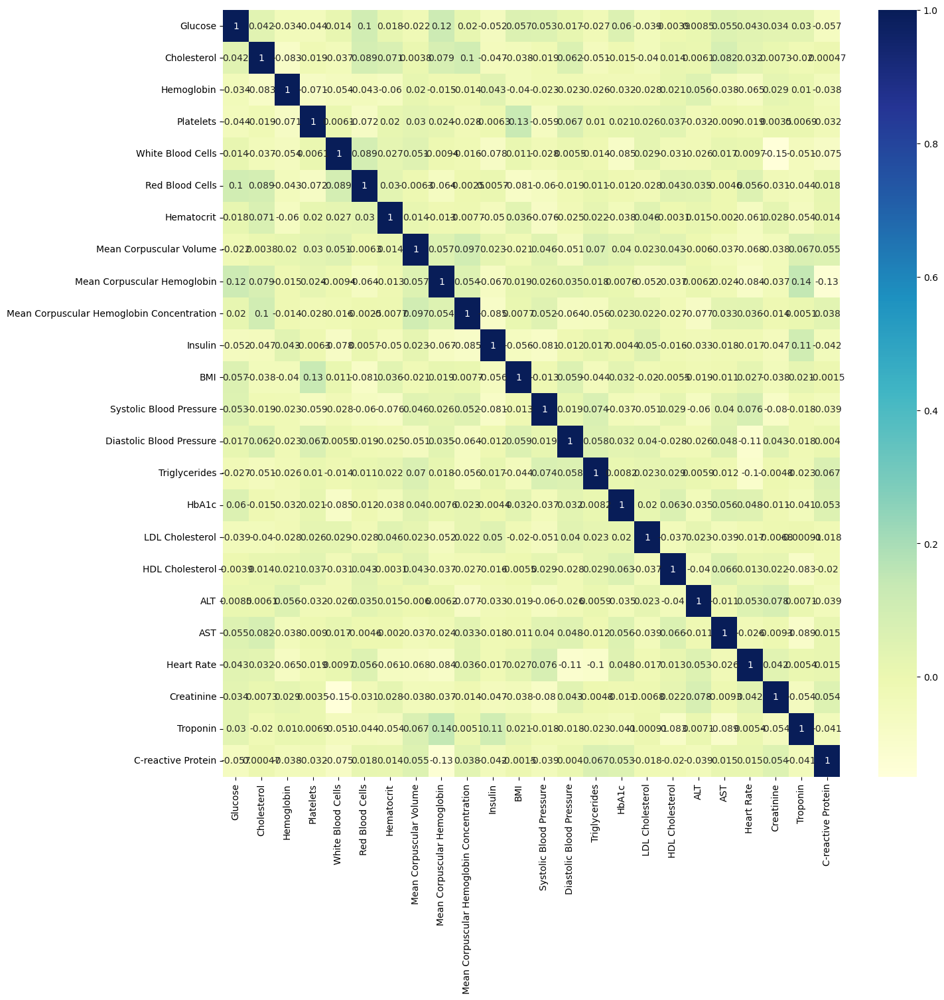

In [10]:
plt.figure(figsize=(15,15))
sns.heatmap(data.corr(), annot=True,cmap="YlGnBu")
plt.show()

# Data Splitting

In [11]:
from sklearn.model_selection import train_test_split

In [12]:
x = data.drop(["Disease"],axis =1)
y = data["Disease"]

In [13]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state = 42)
x_train.shape, y_train.shape, x_test.shape, y_test.shape

((388, 24), (388,), (98, 24), (98,))

# K-Nearest Neighbors

In [14]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors=1)
knn.fit(x_train,y_train)

KNeighborsClassifier(n_neighbors=1)

In [15]:
y_pred = knn.predict(x_test)

In [16]:
print("Accuracy:",metrics.accuracy_score(y_test,y_pred))

Accuracy: 0.4387755102040816


# Support Vector Machine

In [17]:
from sklearn.svm import LinearSVC
svm=LinearSVC(random_state=0)
svm.fit(x_train,y_train)

LinearSVC(random_state=0)

In [18]:
svm_pred=svm.predict(x_test)

In [19]:
print("Accuracy:",metrics.accuracy_score(y_test,svm_pred))

Accuracy: 0.6938775510204082


# Decision Tree Classifier

In [20]:
from sklearn.tree import DecisionTreeClassifier
clf=DecisionTreeClassifier()
clf=clf.fit(x_train,y_train)

In [21]:
clf_pred=clf.predict(x_test)

In [22]:
print("Accuracy:",metrics.accuracy_score(y_test,clf_pred))

Accuracy: 0.9591836734693877


# Naive Bayes

In [23]:
from sklearn.naive_bayes import GaussianNB
nb=GaussianNB()
nb.fit(x_train,y_train)

GaussianNB()

In [24]:
nb_pred=nb.predict(x_test)

In [25]:
print("Accuracy:",metrics.accuracy_score(y_test,nb_pred))

Accuracy: 0.7040816326530612


# Gradient Boosting Classifier

In [26]:
from sklearn.ensemble import GradientBoostingClassifier
gbc = GradientBoostingClassifier(max_depth=4,learning_rate=0.7)
gbc.fit(x_train,y_train)

GradientBoostingClassifier(learning_rate=0.7, max_depth=4)

In [27]:
gbc_pred=gbc.predict(x_test)

In [28]:
print("Accuracy:",metrics.accuracy_score(y_test,gbc_pred))

Accuracy: 0.9183673469387755


# Multi-layer Perceptron

In [29]:
from sklearn.neural_network import MLPClassifier
mlp = MLPClassifier()
mlp.fit(x_train,y_train)

C:\Users\Srija-Pooja\anaconda3\anaconda\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


MLPClassifier()

In [30]:
mlp_pred=gbc.predict(x_test)

In [31]:
print("Accuracy:",metrics.accuracy_score(y_test,mlp_pred))

Accuracy: 0.9183673469387755


# Logistic Regression

In [32]:
from sklearn.linear_model import LogisticRegression
log = LogisticRegression()
log.fit(x_train,y_train)

C:\Users\Srija-Pooja\anaconda3\anaconda\Lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression()

In [33]:
log_pred=log.predict(x_test)

In [34]:
print("Accuracy:",metrics.accuracy_score(y_test,log_pred))

Accuracy: 0.6530612244897959


In [35]:
Models = ['KNeighborsClassifier','Support Vector Machine','Decision Tree Classifier','Naive Bayes','Gradient Boosting Classifier','MLPClassifier','LogisticRegression']
Accuracy=[metrics.accuracy_score(y_test,y_pred),metrics.accuracy_score(y_test,svm_pred),metrics.accuracy_score(y_test,clf_pred),metrics.accuracy_score(y_test,nb_pred),metrics.accuracy_score(y_test,gbc_pred),metrics.accuracy_score(y_test,mlp_pred),metrics.accuracy_score(y_test,log_pred)]
df_models = pd.DataFrame(data = [Accuracy], index = ['Accuracy'], columns = Models)
df_models.T

,Accuracy
KNeighborsClassifier,0.438776
Support Vector Machine,0.693878
Decision Tree Classifier,0.959184
Naive Bayes,0.704082
Gradient Boosting Classifier,0.918367
MLPClassifier,0.918367
LogisticRegression,0.653061


In [36]:
#Storing best model
from sklearn.tree import DecisionTreeClassifier
clf=DecisionTreeClassifier()
clf=clf.fit(x_train,y_train)

In [37]:
clf_pred=clf.predict(x_test)

In [38]:
print("Accuracy:",metrics.accuracy_score(y_test,clf_pred))

Accuracy: 0.9693877551020408


In [39]:
cnf_matrix = confusion_matrix(y_test,clf_pred)

In [40]:
print(cnf_matrix)

[[20  0  0  0  0  0]
 [ 0 59  0  0  0  0]
 [ 0  0  0  0  0  0]
 [ 1  1  1  4  0  0]
 [ 0  0  0  0  9  0]
 [ 0  0  0  0  0  3]]


<Axes: >

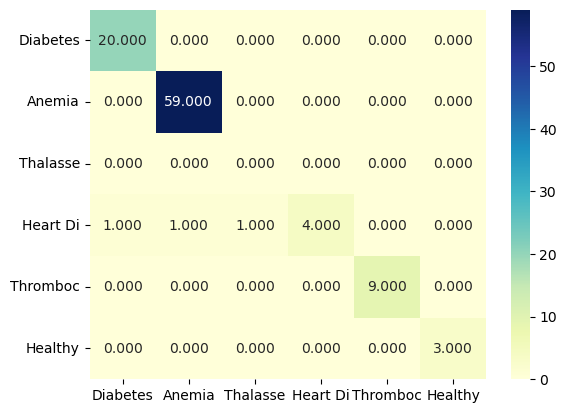

In [41]:
import seaborn as sns
labels = ["Diabetes","Anemia","Thalasse","Heart Di","Thromboc","Healthy"]
sns.heatmap(cnf_matrix, annot=True, cmap="YlGnBu", fmt=".3f", xticklabels=labels, yticklabels=labels)

In [42]:
prediction = clf.predict(np.array([[0.11,0.76,0.65,0.111,0.128,0.34,0.67,0.89,0.48,0.78,0.98,0.113,0.48,0.46,0.86,0.67,0.73,0.70,0.68,0.35,0.81,0.61,0.89,0.28]]))
print(prediction)

['Diabetes']


C:\Users\Srija-Pooja\anaconda3\anaconda\Lib\site-packages\sklearn\base.py:439: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


In [43]:
prediction1 = clf.predict(np.array([[0.54,0.30,0.55,0.47,0.55,0.66,0.93,0.33,0.58,0.58,0.38,0.55,0.48,0.46,0.86,0.67,0.73,0.70,0.68,0.44,0.55,0.21,0.44,0.07]]))
print(prediction1)

['Heart Di']


C:\Users\Srija-Pooja\anaconda3\anaconda\Lib\site-packages\sklearn\base.py:439: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


In [44]:
prediction2 = clf.predict(np.array([[0.43,0.069,0.55,0.37,0.48,0.11,0.10,0.63,0.58,0.58,0.38,0.55,0.48,0.46,0.86,0.67,0.73,0.70,0.68,0.44,0.55,0.21,0.44,0.07]]))
print(prediction2)

['Anemia']


C:\Users\Srija-Pooja\anaconda3\anaconda\Lib\site-packages\sklearn\base.py:439: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


# Feature Importance

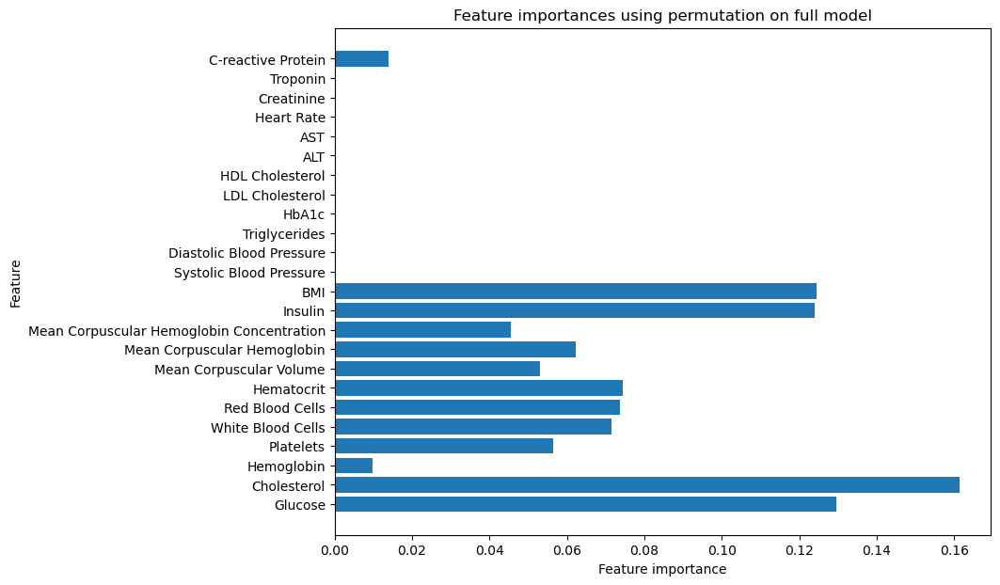

In [45]:
plt.figure(figsize=(9,7))
n_features = x_train.shape[1]
plt.barh(range(n_features), clf.feature_importances_, align='center')
plt.yticks(np.arange(n_features), x_train.columns)
plt.title("Feature importances using permutation on full model")
plt.xlabel("Feature importance")
plt.ylabel("Feature")
plt.show()